# Object Detection of Chinese Traffic Sign  
Faster R-CNN-ResNet101 Object Detection Model Trained by TT100K Dataset.  

Reference:  
1.[TensorFlow Object Detection API](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md)  
2.[TT100K Dataset](https://cg.cs.tsinghua.edu.cn/traffic-sign/tutorial.html)

## Import packages

In [1]:
#!/usr/bin/env python
# -*- coding: utf-8 -*-
import os
import sys
import time
import cv2
import numpy as np
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util
%matplotlib inline
import matplotlib
from matplotlib import pyplot as plt
from PIL import Image

## Load pre-trained models and class name

In [2]:
# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = './pb/20200414_faster_rcnn_resnet101_TSR.pb'
# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = './pb/tt100k_label_map.pbtxt'
# Number of classes
NUM_CLASSES = 221


detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(
    label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

## Image path

In [6]:
path = './images_example/'
# path = './images_adv/'
filenames = os.listdir(path)
filenames

['2666.jpg',
 '364.jpg',
 '3668.jpg',
 '5051.jpg',
 '61448.jpg',
 '62247.jpg',
 '6769.jpg',
 '72461.jpg',
 '7433.jpg',
 '8169.jpg']

## Begin detection

置信度Top 5：
pne	99.85%
i5	98.32%
i4	6.44%
pn	1.48%
p23	0.24%


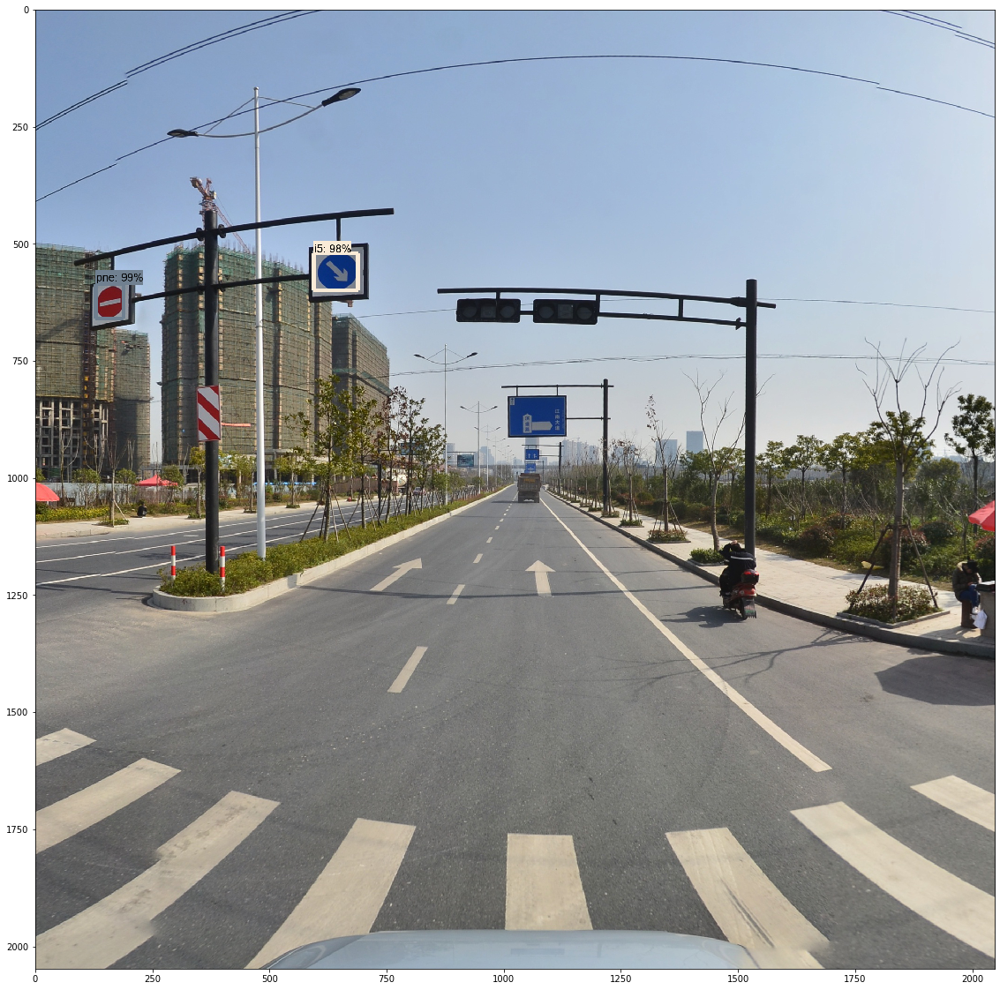

置信度Top 5：
p23	54.92%
pl40	44.12%
pne	41.87%
i5	32.82%
p19	32.07%


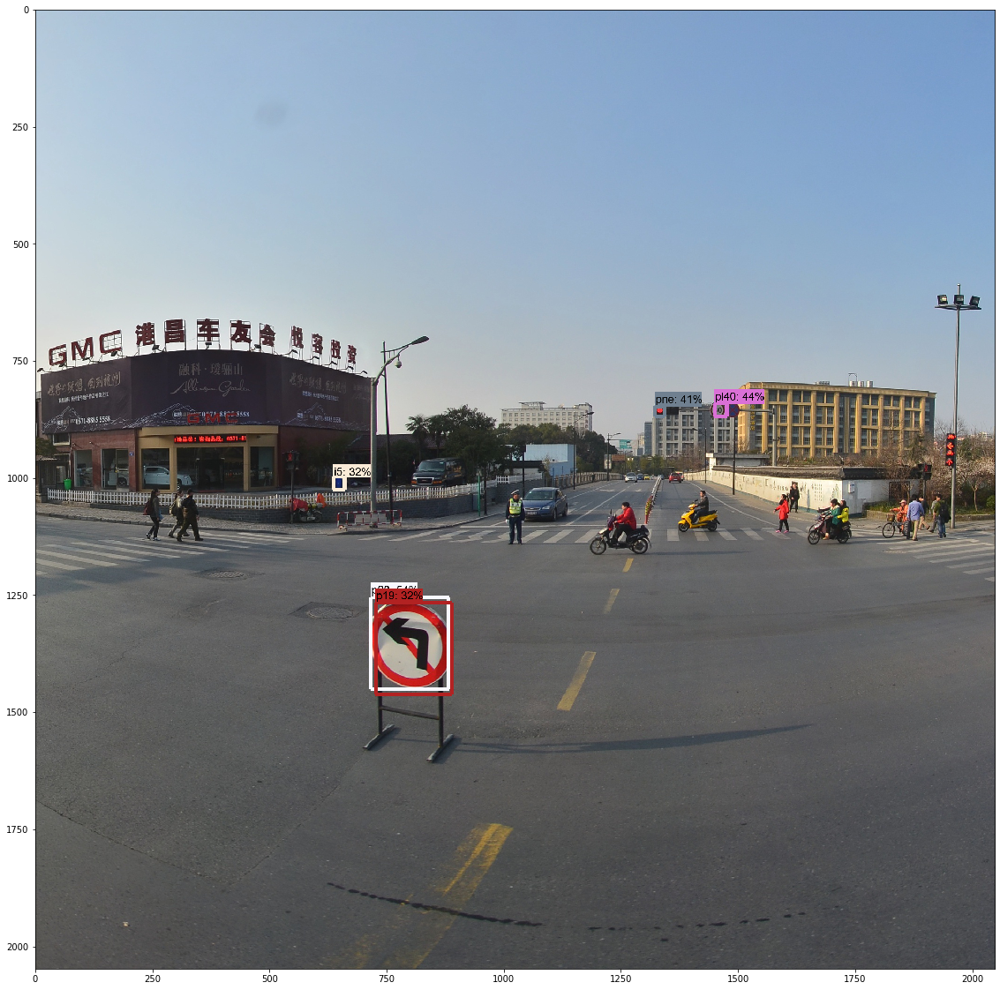

置信度Top 5：
pn	99.83%
i4	62.79%
pl50	61.68%
io	60.61%
i4	53.67%


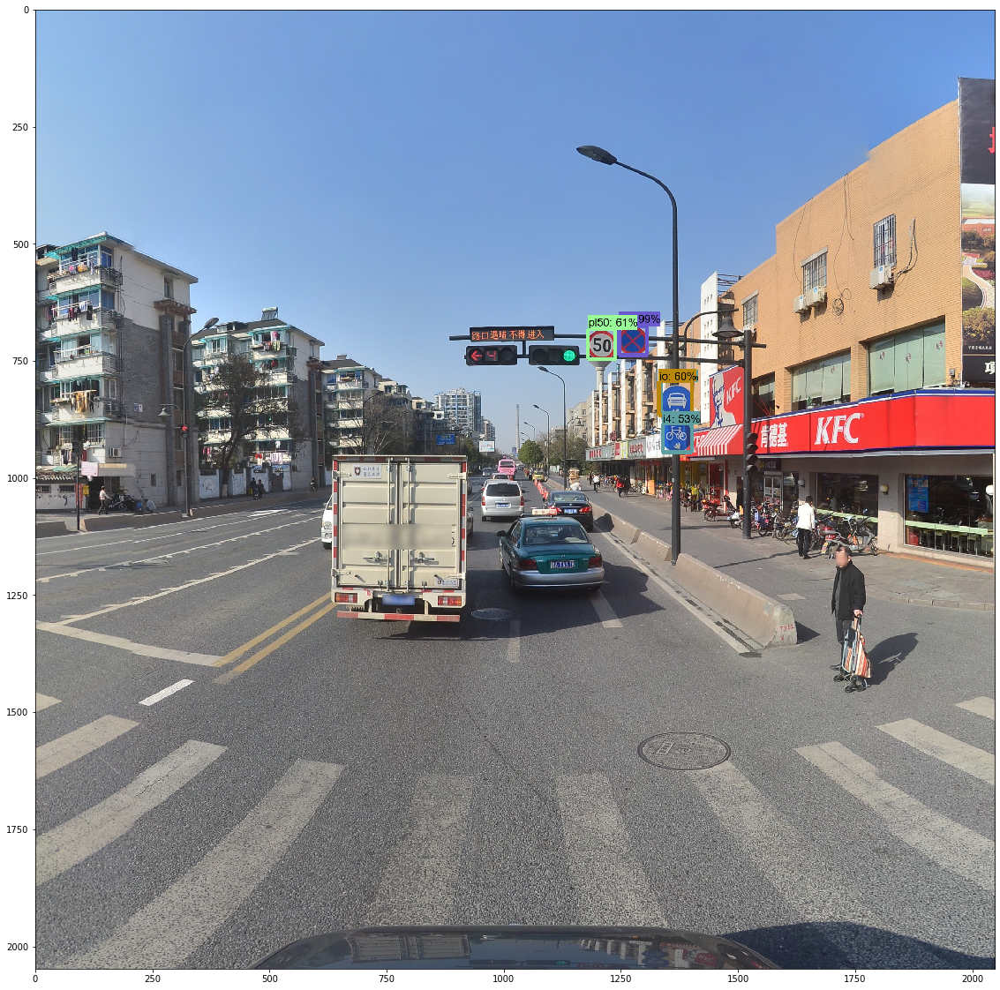

置信度Top 5：
pl40	57.31%
pl80	36.86%
pl60	33.58%
pne	8.19%
p11	4.87%


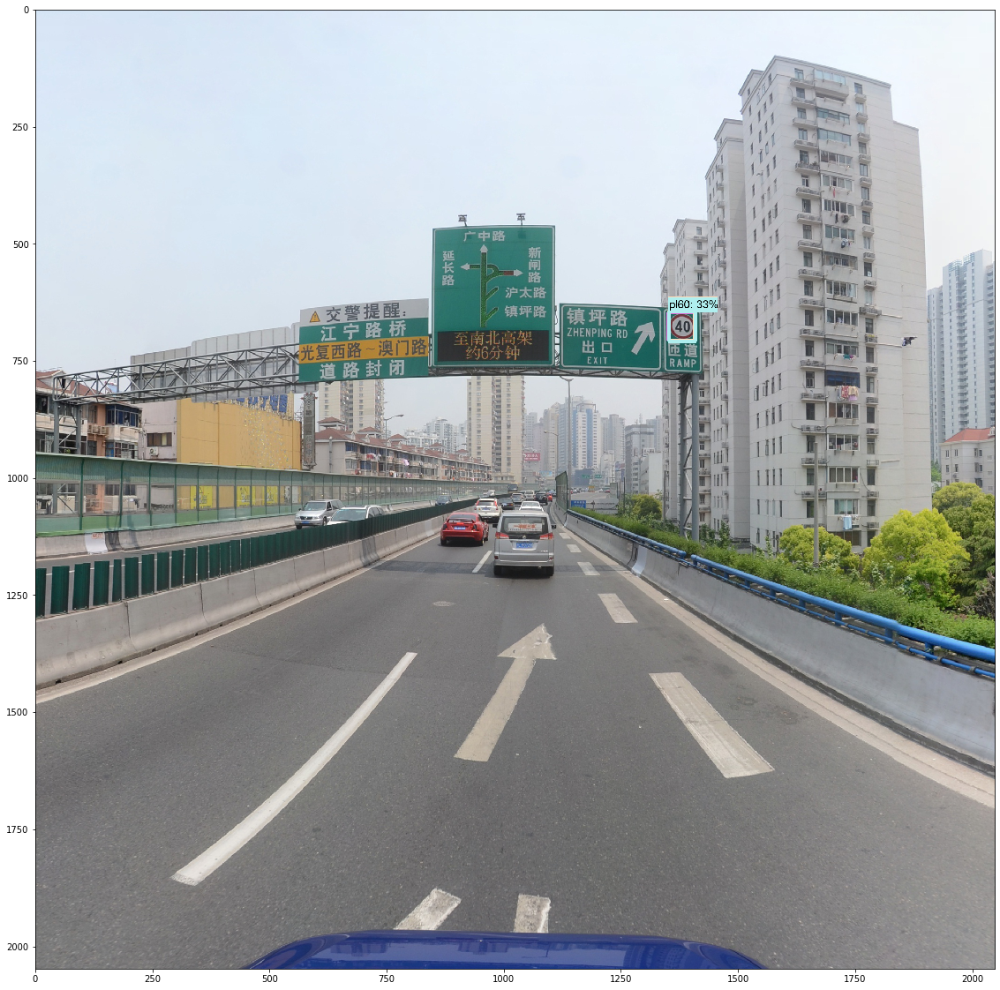

置信度Top 5：
pne	99.75%
i2	49.70%
pn	45.89%
i4	38.81%
po	33.16%


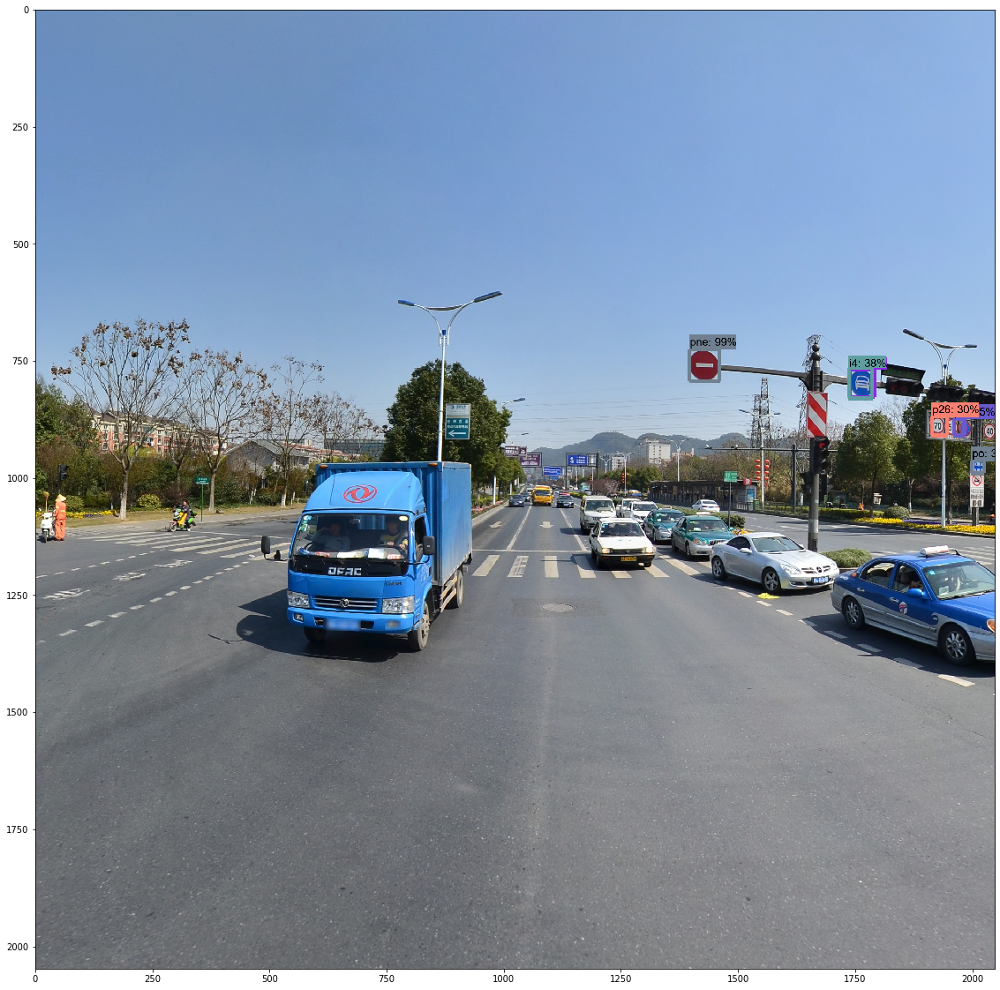

置信度Top 5：
io	99.17%
io	98.64%
p11	80.90%
p11	80.75%
p26	46.05%


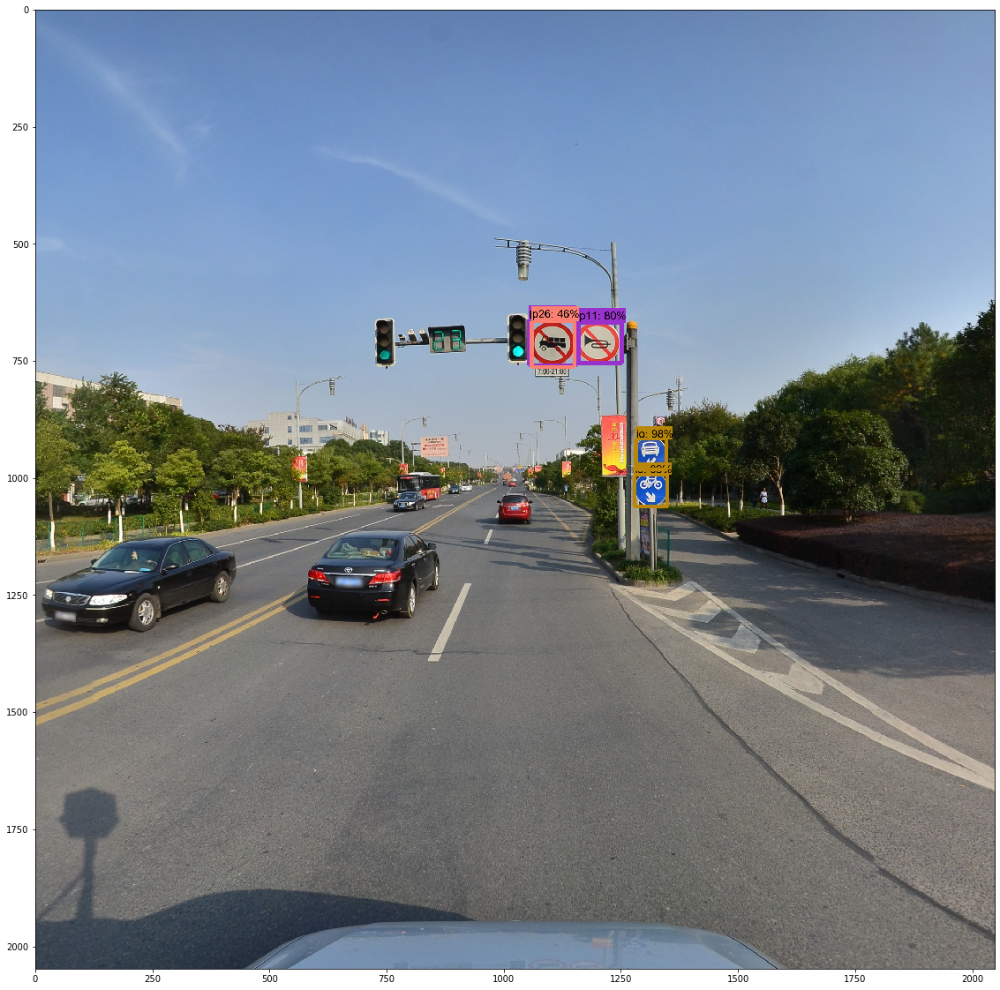

置信度Top 5：
pm55	16.66%
po	14.66%
pl20	9.29%
pl5	8.36%
ph4	8.15%


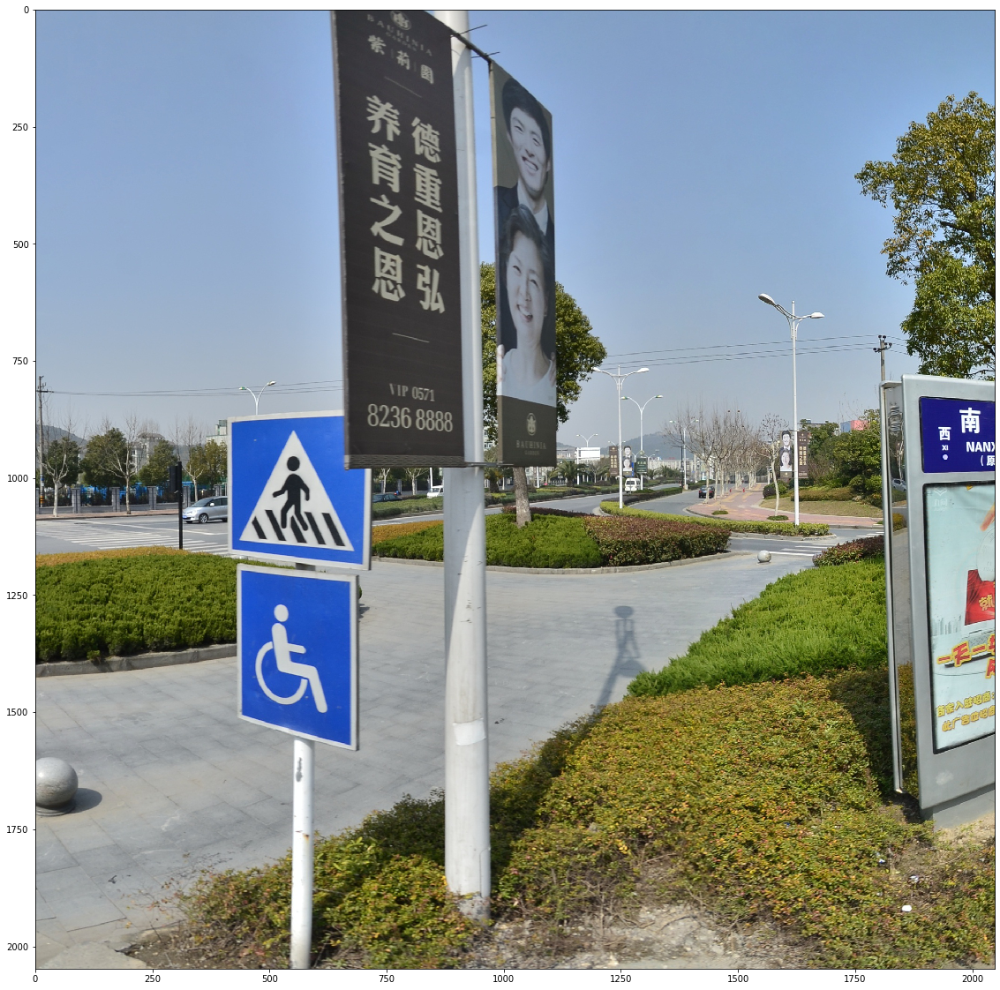

置信度Top 5：
pl60	62.67%
pl40	26.04%
pl80	21.40%
pl100	3.26%
pl30	2.40%


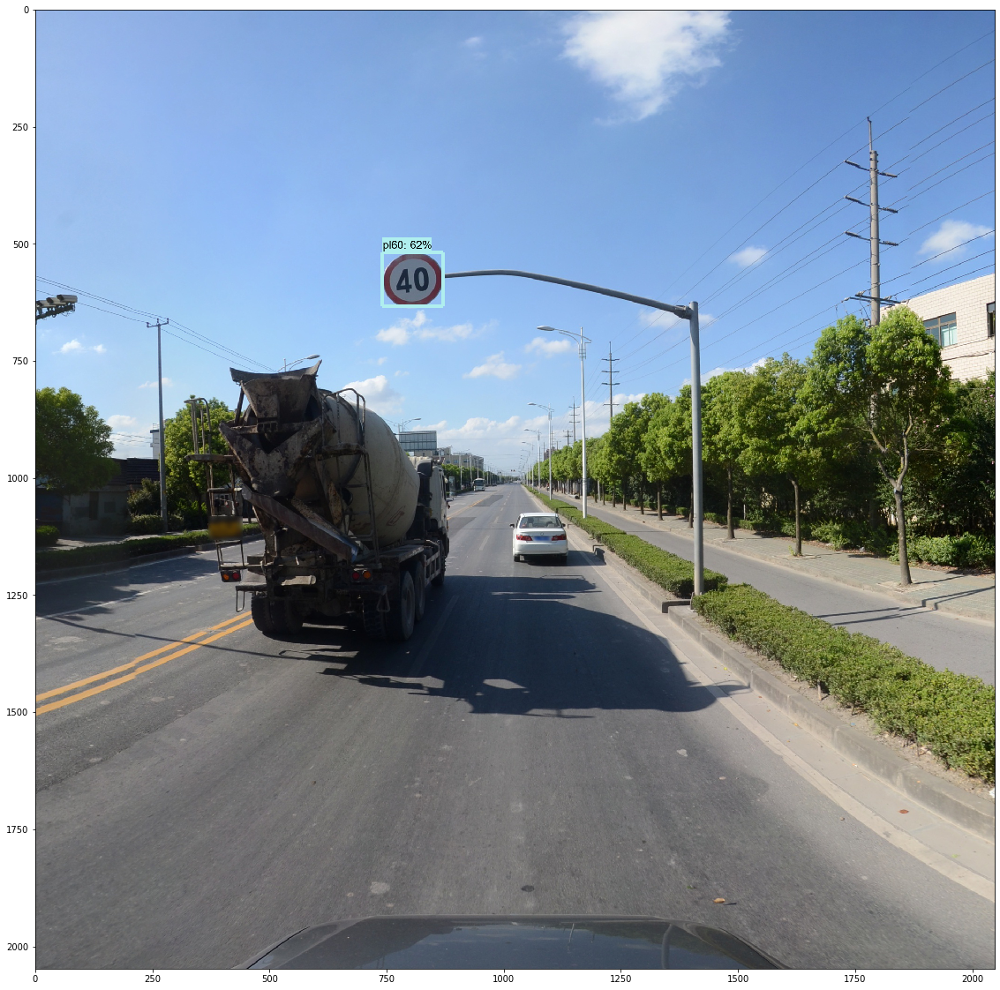

置信度Top 5：
pn	98.54%
p11	83.02%
pl40	46.60%
pl60	28.74%
pl50	25.14%


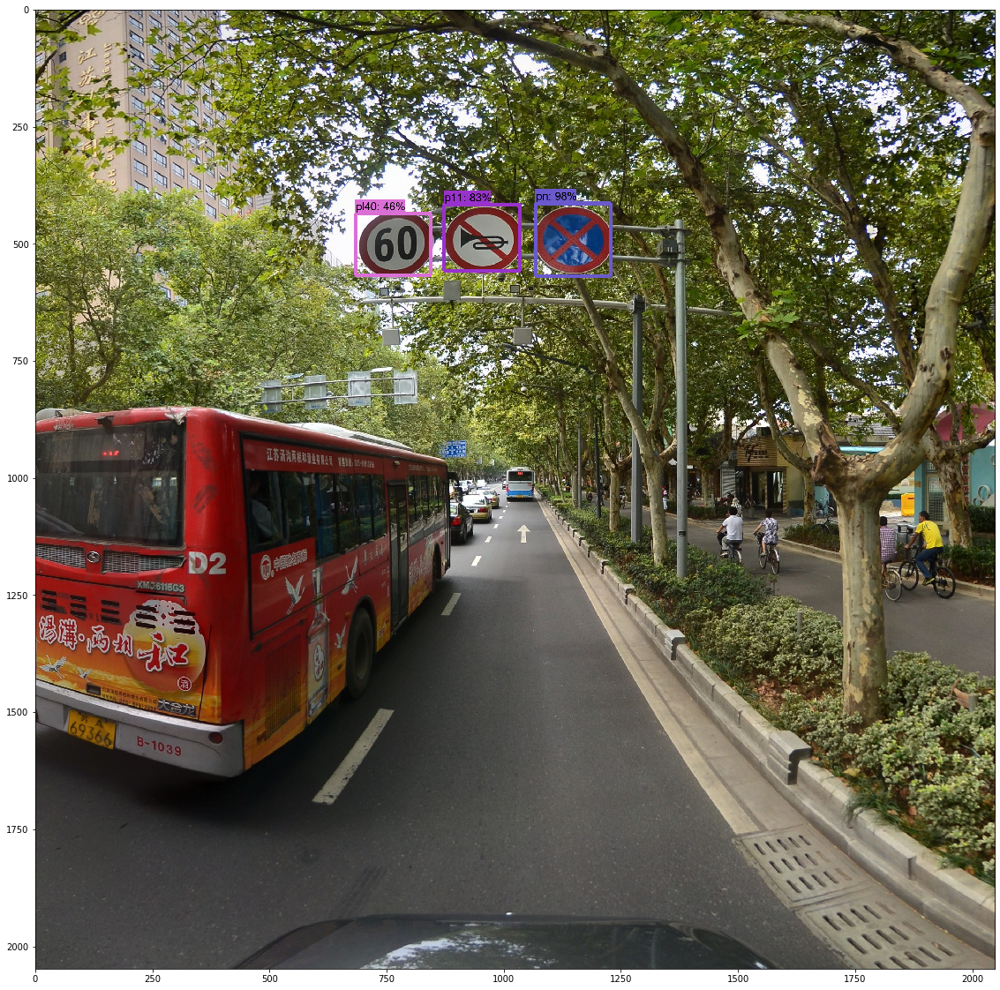

置信度Top 5：
pne	94.25%
pl120	78.92%
il100	69.52%
p26	59.05%
il60	51.11%


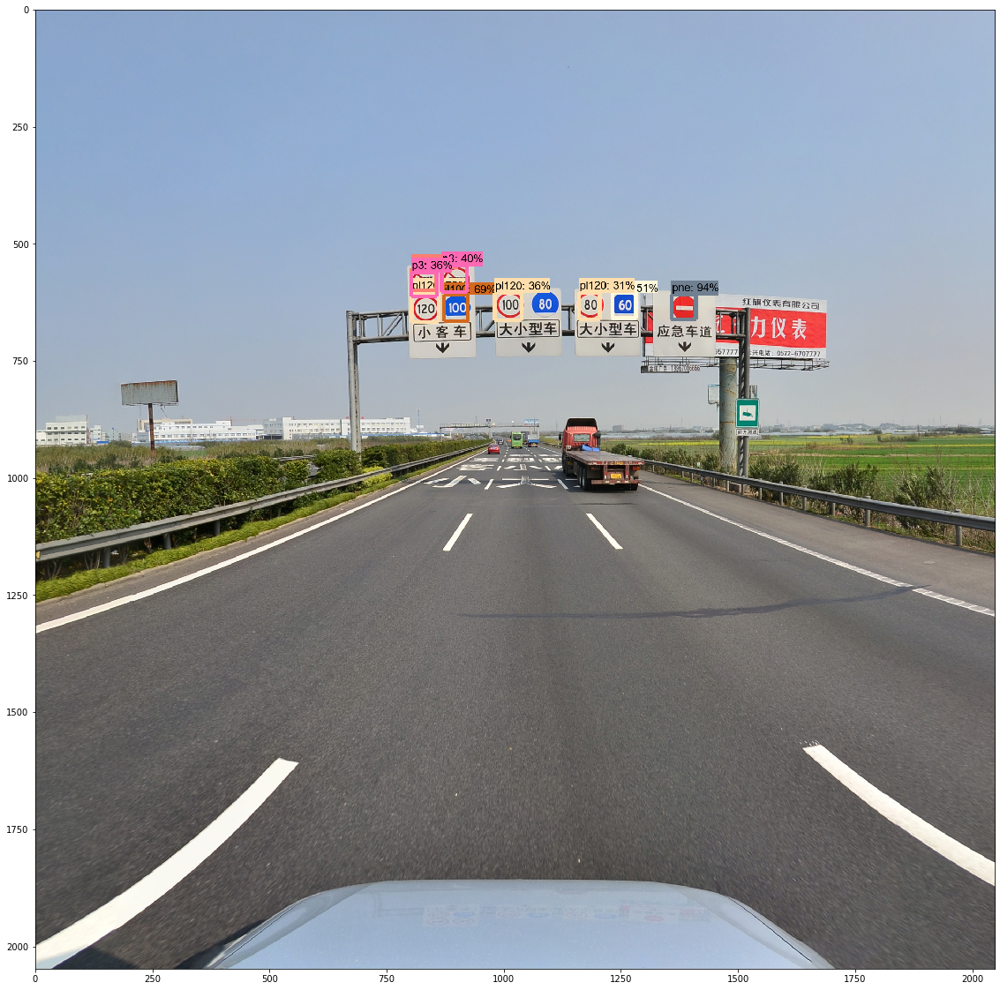

In [8]:
# Define a function to load category ID
def get_id(name):
    for i in categories:
        if i['name'] == name:
            return i['id']

# Define a function to load images
def load_image_into_numpy_array(image):
    (im_width, im_height) = image.size
    return np.array(image.getdata()).reshape(
          (im_height, im_width, 3)).astype(np.uint8)

# Declare a list to store results
results = []

# Begin detection
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:    
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        
        for i in range(len(filenames)):
            image = Image.open(path + filenames[i])
            image_np = load_image_into_numpy_array(image)
            image_np_expanded = np.expand_dims(image_np, axis=0)
        
            # Actual detection.
            (boxes, scores, classes, nums) = sess.run(
                [detection_boxes, detection_scores, detection_classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                min_score_thresh=0.3,
                use_normalized_coordinates=True,
                line_thickness=8)
            
            print("置信度Top 5：")
            for j in range(5):
                print("%s\t%.2f%%"%((category_index[int(classes[0, j])]['name']), scores[0, j]*100))
            
            # TODO: print results in string format
            
            plt.figure(figsize=(20,20))
            plt.imshow(image_np)
            plt.show()
            
            savename = time.strftime("%Y%m%d_%H%M%S", time.localtime()) + '_' + filenames[i]
            aaa = cv2.cvtColor(image_np.copy(),cv2.COLOR_RGB2BGR)
            cv2.imwrite('./images_predict/' + savename, aaa)
            
            results.append(image_np.copy())

## Use webcam for detection (Separate)

In [17]:
# Begin detection
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:    
        # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        
        vid = cv2.VideoCapture(0)
        while True:
            return_value, image = vid.read()
            
            image_np = np.array(image, dtype=np.uint8)
            image_np_expanded = np.expand_dims(image_np, axis=0)
        
            # Actual detection.
            (boxes, scores, classes, nums) = sess.run(
                [detection_boxes, detection_scores, detection_classes, num_detections],
                feed_dict={image_tensor: image_np_expanded})
            # Visualization of the results of a detection.
            vis_util.visualize_boxes_and_labels_on_image_array(
                image_np,
                np.squeeze(boxes),
                np.squeeze(classes).astype(np.int32),
                np.squeeze(scores),
                category_index,
                min_score_thresh=0.3,
                use_normalized_coordinates=True,
                line_thickness=8)
            
            # TODO: print results in string format
            
            result = np.asarray(image_np)
            cv2.namedWindow("result", cv2.WINDOW_AUTOSIZE)
            cv2.imshow("result", result)
            if cv2.waitKey(1) & 0xFF == ord('q'): 
                vid.release()                
                cv2.destroyAllWindows()
                break